In [46]:
import numpy as np
import numba
from numba import typed, types
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [7]:
state = np.random.randint(0, 2, (10, 10))
state

array([[1, 0, 1, 1, 0, 0, 0, 0, 0, 0],
       [0, 1, 0, 1, 0, 0, 0, 1, 1, 0],
       [0, 0, 0, 0, 0, 0, 1, 1, 1, 0],
       [0, 0, 0, 0, 1, 0, 0, 1, 0, 1],
       [1, 0, 1, 0, 0, 1, 1, 0, 1, 1],
       [0, 0, 1, 0, 1, 0, 1, 1, 1, 1],
       [1, 1, 1, 0, 1, 0, 0, 1, 1, 0],
       [1, 1, 1, 1, 1, 0, 0, 0, 1, 1],
       [0, 0, 0, 0, 1, 1, 1, 0, 1, 1],
       [0, 1, 1, 0, 0, 1, 0, 0, 1, 0]])

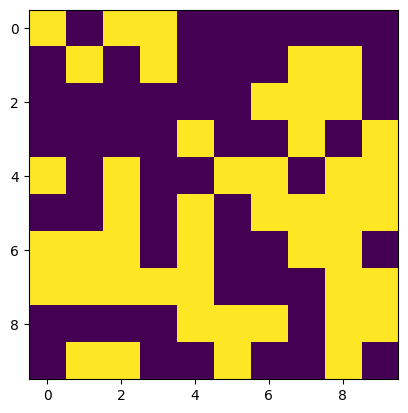

In [10]:
plt.imshow(state)

In [37]:
@numba.njit
def next_cell_state(state, i, j):
    height, width = state.shape

    count = -state[i, j]
    for di in range(-1, 2):
        for dj in range(-1, 2):
            count += state[(i + di) % height, (j + dj) % width]
    
    if state[i, j] == 0 and count == 3:
        return 1
    if state[i, j] == 1 and (count == 2 or count == 3):
        return 1
    
    return 0        

In [77]:
#@numba.njit(numba.int64[:, :](numba.int64[:, :]))
@numba.njit(parallel=True)
def next_state(state):
    height, width = state.shape
    new_state = np.zeros_like(state)
    
    for i in numba.prange(height):
        for j in range(width):
            new_state[i, j] = next_cell_state(state, i, j)
            
    return new_state

In [78]:
@numba.njit
def calculate_states(nsteps):
    initial_condition = np.random.randint(0, 2, (2000, 2000))
    states = typed.List()
    states.append(initial_condition)
    #states = [initial_condition]

    for i in range(nsteps):
        states.append(next_state(states[-1]))
        
    return states

In [79]:
states = calculate_states(100)

In [80]:
fig, ax = plt.subplots(figsize=(5, 5))
img = ax.imshow(states[0])
fig.subplots_adjust(0, 0, 1, 1)
plt.close()

def animate(i):
    img.set_data(states[i])
    return (img,)

anim = animation.FuncAnimation(fig, animate, frames=len(states), interval=200, blit=True)
HTML(anim.to_jshtml())

Animation size has reached 21603762 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
